# Satellite Image Synthesis from a Map

Realistic satellite image synthesis from a rough map using a conditional image generation method: `pix2pix`

## Methods Used
We will implement the Pix2pix method, which is a cGAN (Conditional Generative Adversarial Network).  
GANs are generative models that learn to generate an output image (y) from a noise vector (z): G : z → y.  
Here, we use a `cGAN`, a conditional GAN that produces an image (y) from an input image (x) and a noise vector (z): G : {x, z} → y.  
This is well-suited to our problem, as we want to generate a satellite image (y) from a map image (x).

cGANs, like GANs, are composed of a generator (the forger) and a discriminator (the art critic).  
The `generator` is trained to produce images that are indistinguishable from "real" images — it tries to fool the discriminator.  
The `discriminator` must succeed in distinguishing "fake"/generated images from "real" ones.  
The discriminator maximizes the loss function, while the generator minimizes it — they are playing a MINIMAX game.

The generator has a U-Net-like architecture, and the discriminator is a Patch-GAN.  
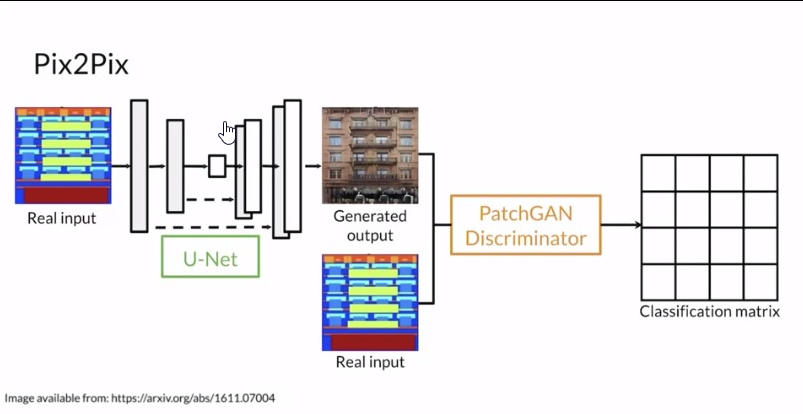

We will use `TensorFlow` to implement our model.

## Dataset
We will use the dataset available online at: http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/maps.  
It contains 1096 images for training and 1098 images for testing.  
These images, sized (600x1200), each correspond to 2 images: satellite (600x600) and map (600x600).  
The dataset is already divided into `train` and `val` folders.


## Code

To begin, we need to install the necessary packages, in particular:
- tensorflow
- matplotlib

Run the line below to automatically install the required packages.

In [1]:
!pip install matplotlib>=3.2.2 tensorflow

ERROR: Could not find a version that satisfies the requirement tarfile (from versions: none)
ERROR: No matching distribution found for tarfile


In [5]:
import tensorflow as tf
import tarfile
import os
import pathlib
import time
import datetime
from matplotlib import pyplot as plt
from IPython import display

In [6]:

gpus = tf.config.list_physical_devices('GPU')
if gpus:
    print(f"✅ GPU is available: {gpus[0].name}")
else:
    print("❌ GPU not available. Using CPU.")


✅ GPU is available: /physical_device:GPU:0


Constants:

In [8]:
IMG_WIDTH = 256
IMG_HEIGHT = 256
IMG_SIZE = (IMG_WIDTH, IMG_HEIGHT)
BUFFER_SIZE = 1000
BATCH_SIZE = 1
OUTPUT_CHANNELS = 3

### Loading and Preprocessing the Dataset:

In [11]:
# !wget -nc http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/maps.tar.gz -O /kaggle/working/maps.tar.gz

# os.makedirs('/kaggle/working/maps', exist_ok=True) 
# with tarfile.open('/kaggle/working/maps.tar.gz', 'r:gz') as tar:
#     tar.extractall('/kaggle/working/maps/')  # Extract here

# data_dir = '/kaggle/working/maps'
# print("Contents:", os.listdir(data_dir))

# train_dir = os.path.join(data_dir, 'train')
# val_dir = os.path.join(data_dir, 'val')
# print(f"Train samples: {len(os.listdir(train_dir))}")
# print(f"Val samples: {len(os.listdir(val_dir))}")

In [18]:
sample_image = tf.io.read_file(str('/kaggle/input/images/maps/train/1.jpg'))
sample_image = tf.io.decode_jpeg(sample_image)
print(sample_image.shape)

(600, 1200, 3)


An image (600x1200) corresponds to 2 images: satellite (600x600) and map (600x600).  
We will need to split them into two separate images and resize them to the format `IMG_SIZE = (256, 256)`.

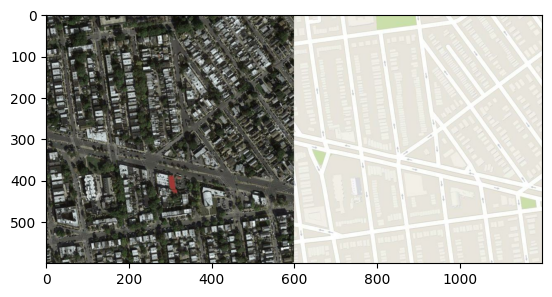

In [19]:
plt.figure()
plt.imshow(sample_image)

In [20]:
def resize(input_image, img_size):
    return tf.image.resize(input_image, [img_size[0],img_size[1]],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

In [22]:
def get_seperated_images(image_file, img_size = IMG_SIZE):
    
    image = tf.io.read_file(image_file)
    image = tf.io.decode_jpeg(image)
    
    # We split the images in half along the width (width//2)
    w = tf.shape(image)[1]
    w = w // 2
    map_image = image[:, w:]
    sat_image = image[:, :w]
    
    # We convert these np.arrays into float tensors
    map_image = tf.cast(map_image, tf.float32)
    sat_image = tf.cast(sat_image, tf.float32)
    return resize(map_image, img_size), resize(sat_image, img_size)

Let's test the `get_separated_images` function by displaying the images and their respective shapes.

(256, 256, 3)
(256, 256, 3)
<class 'tensorflow.python.framework.ops.EagerTensor'>


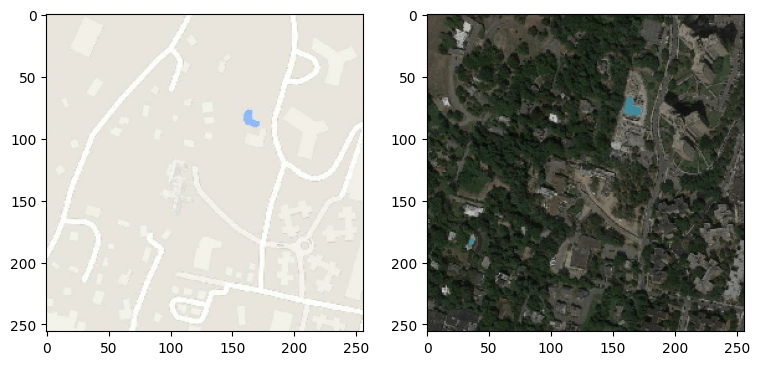

In [24]:
image_map, image_satellite = get_seperated_images(str('/kaggle/input/images/maps/train/100.jpg'), IMG_SIZE)
print(image_map.shape)
print(image_satellite.shape)
print(type(image_map))

plt.figure(figsize=(9,7))
plt.subplot(1, 2, 1)
plt.imshow(image_map / 255.0)
plt.subplot(1, 2, 2)
plt.imshow(image_satellite / 255.0)

We apply a "Random jitter" to the data using the `random_jitter` function, as explained in the *Pix2Pix* paper.  
This involves resizing the image to a larger size (286x286) and then randomly cropping it to 256x256 (`random_crop`).  
We also apply a mirroring effect to the data ("mirroring") using `random_mirroring`.  
Then, we rescale the pixel values to be between -1 and 1.

Preprocessing must be applied to both the input and output images simultaneously,  
so that they undergo the same transformations — for example, when calling `random_crop` or `random_mirroring`.

In [26]:
@tf.function()
def random_jitter(input_image, real_image):
    input_image = resize(input_image, (286, 286)) 
    real_image = resize(real_image, (286, 286))
    
    def random_crop(input_image, real_image):
        stacked_image = tf.stack([input_image, real_image], axis=0)
        cropped_image = tf.image.random_crop(stacked_image, 
                                             size=[2, IMG_HEIGHT, IMG_WIDTH, 3])
        return cropped_image[0], cropped_image[1]
    
    return random_crop(input_image, real_image)

def random_mirroring(input_image, real_image):
    if tf.random.uniform(()) > 0.5:
        input_image = tf.image.flip_left_right(input_image)
        real_image = tf.image.flip_left_right(real_image)
    return input_image, real_image

def rescaling(image):
    return (image / 127.5) - 1

def load_image_train(image_file):
    input_image, real_image = get_seperated_images(image_file)
    input_image, real_image = random_jitter(input_image, real_image)
    input_image, real_image = random_mirroring(input_image, real_image)
    input_image, real_image = rescaling(input_image), rescaling(real_image)
    return input_image, real_image

def load_image_test(image_file):
    input_image, real_image = get_seperated_images(image_file)
    input_image, real_image = rescaling(input_image), rescaling(real_image)
    return input_image, real_image

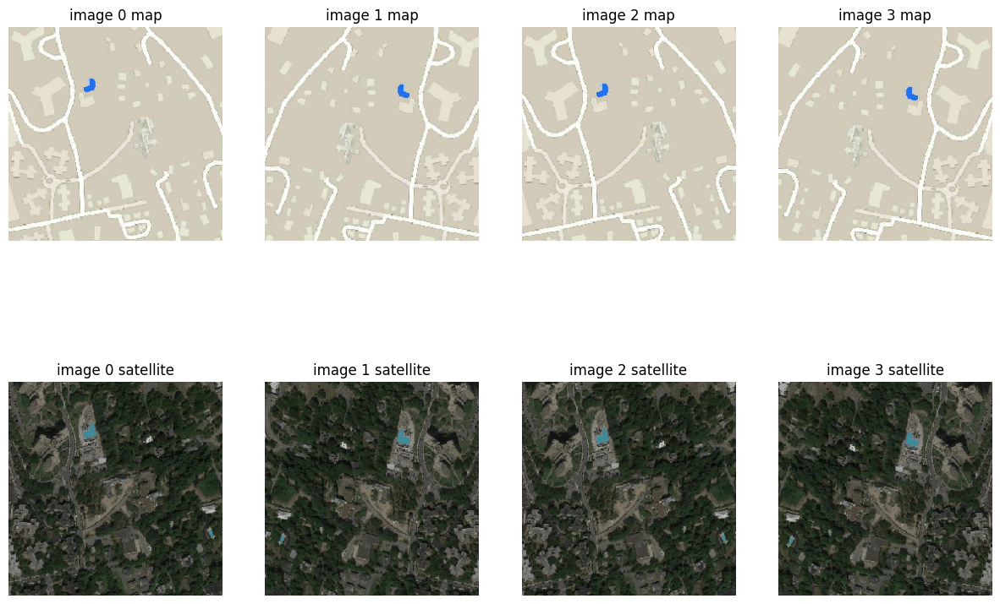

In [28]:
plt.figure(figsize=(15, 10))
for i in range(4):
    input_image, real_image = load_image_train(str('/kaggle/input/images/maps/train/100.jpg'))
    plt.subplot(2, 4, i + 1)
    plt.title(f"image {i} map")
    plt.imshow(input_image)
    plt.axis('off')
    plt.subplot(2, 4, i + 5)
    plt.title(f"image {i} satellite")
    plt.imshow(real_image * 0.5 + 0.5)
    plt.axis('off')
plt.show()

In [30]:
train_dataset = tf.data.Dataset.list_files(str('/kaggle/input/images/maps/train/*.jpg'))
train_dataset = train_dataset.map(load_image_train, num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.cache()\
                             .shuffle(BUFFER_SIZE)\
                             .batch(BATCH_SIZE)\
                             .prefetch(buffer_size=tf.data.AUTOTUNE)

In [32]:
test_dataset = tf.data.Dataset.list_files(str('/kaggle/input/images/maps/val/*.jpg'))
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.cache()\
                           .batch(BATCH_SIZE)\
                           .prefetch(buffer_size=tf.data.AUTOTUNE)

### The Generator

The generator has an architecture similar to “U-Net”; it is an encoder-decoder with a few particularities:
- "Skip connections" between corresponding (mirrored) layers in the encoder and decoder,
- Simple convolutional layers with `stride = 2`,
- Each block is of the form (conv, batch normalization, ReLU or LeakyReLU).

*Skip connections*: This means that each layer in the decoder (except the first) receives an input directly from the corresponding encoder layer.  
They are implemented using the `Concatenate` function from Keras.

Its architecture is (almost) as follows:  
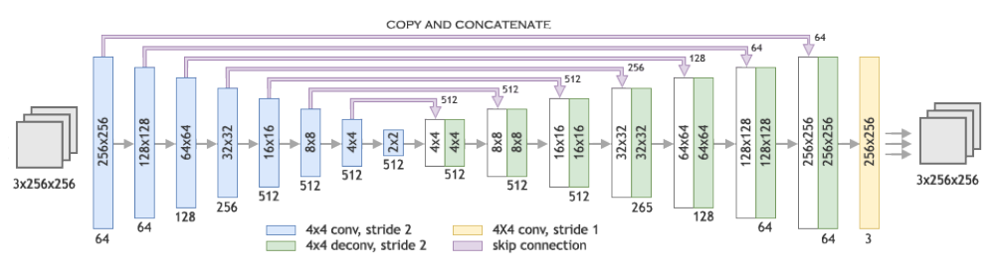

Note: The number of convolutional blocks is not exactly the same as in our Pix2Pix model. This is just to give an idea of the architecture.


According to the Pix2Pix paper, the architectures are as follows:  
**Encoder**: C64-C128-C256-C512-C512-C512-C512-C512  
**Decoder**: CD512-CD512-CD512-C512-C256-C128-C64  
where:
- Ck is a block of Convolution-BatchNorm-(ReLU for the decoder, LeakyReLU for the encoder) with k filters,
- CDk is a block of Convolution-BatchNorm-LeakyReLU with a dropout rate of 50%.

All convolutions are 4x4 filters with a stride of 2. For the decoder, these are transposed convolutions.  
The ReLU or LeakyReLU activations have a slope of 0.2.  
Additionally, after the last decoder layer, a convolution is added to map to the number of channels (`OUTPUT_CHANNELS`), followed by a Tanh activation function.

An `encoder_block` is a Convolution-BatchNorm-LeakyReLU block, with the option to disable normalization using `batch_normalization=False`.

In [33]:
def encoder_block(nb_filters_conv, batch_normalization=True):
    conv_2D = tf.keras.Sequential()
    conv_2D.add(tf.keras.layers.Conv2D(nb_filters_conv, 
                                       4, 
                                       strides=2, 
                                       padding='same', 
                                       use_bias=False))
    if batch_normalization :
        conv_2D.add(tf.keras.layers.BatchNormalization())
    conv_2D.add(tf.keras.layers.LeakyReLU())
    return conv_2D

In [34]:
def decoder_block(nb_filters_conv, dropout=True):
    
    conv_2D_T = tf.keras.Sequential([
        tf.keras.layers.Conv2DTranspose(nb_filters_conv, 
                                        4, 
                                        strides=2, 
                                        padding='same', 
                                        use_bias=False),
        tf.keras.layers.BatchNormalization()
    ])
    if dropout:
        conv_2D_T.add(tf.keras.layers.Dropout(0.5))
    conv_2D_T.add(tf.keras.layers.ReLU())
    return conv_2D_T

In [36]:
def Generator():
    inputs = tf.keras.layers.Input(shape=[256, 256, 3])
    stored_skips_connections =[]
    
    # Start of the encoding
    x = encoder_block(64, batch_normalization=False)(inputs)
    stored_skips_connections.append(x)
    x = encoder_block(128)(x)  # (64, 64, 128)
    stored_skips_connections.append(x)
    x = encoder_block(256)(x)  # ( 32, 32, 256)
    stored_skips_connections.append(x)
    x = encoder_block(512)(x)  # ( 16, 16, 512)
    stored_skips_connections.append(x)
    x = encoder_block(512)(x)  # ( 8, 8, 512)
    stored_skips_connections.append(x)
    x = encoder_block(512)(x)  # ( 4, 4, 512)
    stored_skips_connections.append(x)
    x = encoder_block(512)(x)  # ( 2, 2, 512)
    stored_skips_connections.append(x)
    x = encoder_block(512)(x)  # ( 1, 1, 512)
    
    # Start of the decoding
    x = decoder_block(512)(x)  # ( 2, 2, 1024)
    # stored_skip_connections[6] corresponds to the output of the last encoder with filter = 512
    x = tf.keras.layers.Concatenate()([x, stored_skips_connections[6]])
    
    x = decoder_block(512)(x)  # ( 4, 4, 1024)
    x = tf.keras.layers.Concatenate()([x, stored_skips_connections[5]])
    
    x = decoder_block(512)(x)  # ( 8, 8, 1024)
    x = tf.keras.layers.Concatenate()([x, stored_skips_connections[4]])
    
    x = decoder_block(512, dropout=False)(x)  # ( 16, 16, 1024)
    x = tf.keras.layers.Concatenate()([x, stored_skips_connections[3]])
    
    x = decoder_block(256, dropout=False)(x)  # ( 32, 32, 512)
    # stored_skip_connections[2] corresponds to the output of the last encoder with filter = 256
    x = tf.keras.layers.Concatenate()([x, stored_skips_connections[2]])
    
    x = decoder_block(128, dropout=False)(x)  # ( 64, 64, 256)
    x = tf.keras.layers.Concatenate()([x, stored_skips_connections[1]])
    
    x = decoder_block(64, dropout=False)(x)  # ( 128, 128, 128)
    x = tf.keras.layers.Concatenate()([x, stored_skips_connections[0]])

    outputs = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                              strides=2,
                                              padding='same',
                                              activation='tanh')(x)  # ( 256, 256, 3)

    return tf.keras.Model(inputs=inputs, outputs=outputs)

In [37]:
generator = Generator()
generator.summary()

Model: "functional_15"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 256, 256, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential (Sequential)   │ (None, 128, 128, 64)   │          3,072 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_1 (Sequential) │ (None, 64, 64, 128)    │        131,584 │ sequential[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_2 (Sequential) │ (None, 32, 32, 256)    │        525,312 │ sequential_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_3 (Sequential) │ (None, 16, 16, 512)    │      2,099,200 │ sequential_2[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_4 (Sequential) │ (None, 8, 8, 512)      │      4,196,352 │ sequential_3[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_5 (Sequential) │ (None, 4, 4, 512)      │      4,196,352 │ sequential_4[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_6 (Sequential) │ (None, 2, 2, 512)      │      4,196,352 │ sequential_5[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_7 (Sequential) │ (None, 1, 1, 512)      │      4,196,352 │ sequential_6[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_8 (Sequential) │ (None, 2, 2, 512)      │      4,196,352 │ sequential_7[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 2, 2, 1024)     │              0 │ sequential_8[0][0],    │
│                           │                        │                │ sequential_6[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_9 (Sequential) │ (None, 4, 4, 512)      │      8,390,656 │ concatenate[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_1             │ (None, 4, 4, 1024)     │              0 │ sequential_9[0][0],    │
│ (Concatenate)             │                        │                │ sequential_5[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_10             │ (None, 8, 8, 512)      │      8,390,656 │ concatenate_1[0][0]    │
│ (Sequential)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_2             │ (None, 8, 8, 1024)     │              0 │ sequential_10[0][0],   │
│ (Concatenate)             │                        │                │ sequential_4[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_11             │ (None, 16, 16, 512)    │      8,390,656 │ concatenate_2[0][0]    │
│ (Sequential)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_3             │ (None, 16, 16, 1024)   │              0 │ sequential_11[0][0],   │
│ (Concatenate)        

 Total params: 54,425,859 (207.62 MB)

 Trainable params: 54,414,979 (207.58 MB)

 Non-trainable params: 10,880 (42.50 KB)

### The Discriminator

The discriminator's goal is to distinguish "fake" images from real ones.  
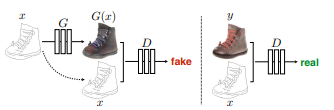  
The discriminator is a convolutional classifier `PatchGAN`, which penalizes at the patch level (not the entire image). In its implementation, Pix2Pix uses patches of size `70x70`.

The discriminator has two inputs: the input image `image_input` (here, our 2D map) and a target image `image_target` (here, our satellite map), which can either be a generated image or a real image.

Its architecture, according to the *Pix2Pix* paper, is: C64-C128-C256-C512.  
After the last layer, a convolution is applied to map to a single output dimension (0/1), followed by a Sigmoid function.  
Note that there is no batchNorm applied to the first layer C64. All ReLUs are Leaky, so we use the `encoder_block` defined earlier.

In [38]:
def Discriminator():

    image_input = tf.keras.layers.Input(shape=[256, 256, 3], name='image_input')
    image_target = tf.keras.layers.Input(shape=[256, 256, 3], name='image_target')

    x = tf.keras.layers.concatenate([image_input, image_target])
    x = encoder_block(64, batch_normalization=False)(x)  # ( 128, 128, 64)
    x = encoder_block(128)(x)  # ( 64, 64, 128)
    x = encoder_block(256)(x)  # ( 32, 32, 256)
    x = encoder_block(512)(x) # (16, 16, 512)
    output = tf.keras.layers.Conv2D(1, 4, strides=2, activation='sigmoid')(x)
    return tf.keras.Model(inputs=[image_input, image_target], outputs=output)

In [39]:
discriminator = Discriminator()
discriminator.summary()

Model: "functional_20"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ image_input (InputLayer)  │ (None, 256, 256, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ image_target (InputLayer) │ (None, 256, 256, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_7             │ (None, 256, 256, 6)    │              0 │ image_input[0][0],     │
│ (Concatenate)             │                        │                │ image_target[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_15             │ (None, 128, 128, 64)   │          6,144 │ concatenate_7[0][0]    │
│ (Sequential)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_16             │ (None, 64, 64, 128)    │        131,584 │ sequential_15[0][0]    │
│ (Sequential)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_17             │ (None, 32, 32, 256)    │        525,312 │ sequential_16[0][0]    │
│ (Sequential)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_18             │ (None, 16, 16, 512)    │      2,099,200 │ sequential_17[0][0]    │
│ (Sequential)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_12 (Conv2D)        │ (None, 7, 7, 1)        │          8,193 │ sequential_18[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 2,770,433 (10.57 MB)

 Trainable params: 2,768,641 (10.56 MB)

 Non-trainable params: 1,792 (7.00 KB)

### Generate and Display the Images

We set `training=True` so that the model generates an image from the given input image.

In [40]:
def generate_images(model, test_input, test_output):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(15, 15))

    display_list = [test_input[0], test_output[0], prediction[0]]
    title = ['Input Image', 'Output Image', 'Generated Image']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        # Conversion of pixels from [-1,1] to [0, 1]
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')

    plt.show()

I0000 00:00:1745133756.621085      31 cuda_dnn.cc:529] Loaded cuDNN version 90300


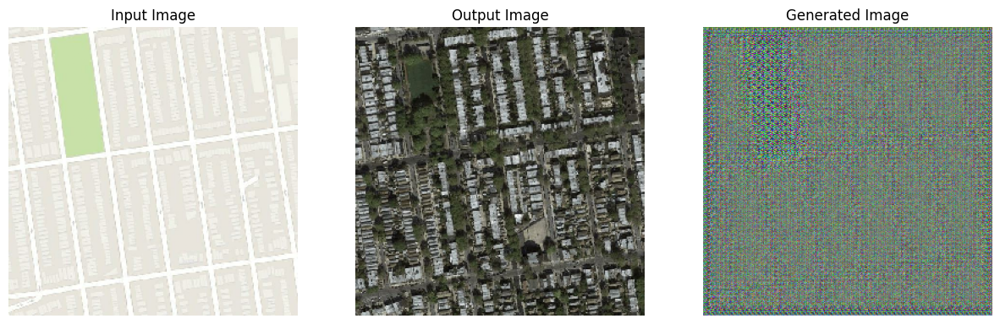

In [41]:
for example_input, example_target in test_dataset.take(1):
    generate_images(generator, example_input, example_target)

### Loss Functions

**Discriminator Loss Function**: It quantifies the discriminator's ability to distinguish real images from fake ones. It is the sum of 2 terms:
- `real_loss`: It compares the real images to an array of 1 (1 for real image).
- `fake_loss`: It compares the fake images to an array of 0 (0 for fake image).

In [42]:
def discriminator_loss(real_output, fake_output):
    real_loss = tf.keras.losses.BinaryCrossentropy()(tf.ones_like(real_output), 
                                                     real_output)
    fake_loss = tf.keras.losses.BinaryCrossentropy()(tf.zeros_like(fake_output), 
                                                     fake_output)
    return real_loss + fake_loss

**Generator Loss Function**: It quantifies how well the generator has succeeded in deceiving the discriminator. The goal is for the generated images ("fake") to be considered real. We also introduce an L1 loss function to ensure the generated image is close to the input image ("ground truth").  
It is the sum of 2 terms:
- `gen_loss`: It compares the generated images, which are considered fake by the discriminator, to an array of 1 (real images).
- `LAMBDA * l1_loss`: The distance between the generated image and the real input image must be minimized.

In the *Pix2Pix* paper, LAMBDA is set to 100.

In [43]:
LAMBDA = 100

def generator_loss(disc_fake_output, real_output, fake_output):
    gen_loss = tf.keras.losses.BinaryCrossentropy()(tf.ones_like(disc_fake_output), 
                                                    disc_fake_output)
    l1_loss = tf.reduce_mean(tf.abs(real_output - fake_output))
    return gen_loss + LAMBDA * l1_loss


The optimizer parameters below are set as per the `Pix2Pix` paper.

In [44]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5, beta_2=0.999)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5, beta_2=0.999)

### Training

The training loop starts with the generator, which generates an image from `input_image`. The discriminator is then used to classify real images (from the training set) and fake images (produced by the generator). The loss is calculated for each of these models, and the gradients are used to update the generator and the discriminator.

In [45]:
# The `tf.function` annotation allows the function to be "compiled"
@tf.function
def train_step(input_image, output_image):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_fake_output = generator(input_image, training=True)

        disc_real_output = discriminator([input_image, output_image], training=True)
        disc_fake_output = discriminator([input_image, gen_fake_output], training=True)

        gen_loss = generator_loss(disc_fake_output, output_image, gen_fake_output)
        disc_loss = discriminator_loss(disc_real_output, disc_fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, 
                                               generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, 
                                                    discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, 
                                            generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, 
                                                discriminator.trainable_variables))

We create checkpoints to regularly save the model's calculated weights. Here, we do so every 10 epochs.

In [46]:
checkpoint_dir = '/kaggle/working'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [47]:
# Restores the last available checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In the `train` function, we train our model one image at a time (BATCH_SIZE=1), as recommended in the *Pix2Pix* paper. At the end of each epoch, we retrieve an `Input Image` from the test dataset, send it to the generator, which returns a generated satellite image `Generated Image`. We then compare it to the real `Output Image`, and display these 3 images.

In [48]:
def train(dataset, epochs, epoch0=0, save_path='/kaggle/working/pix2pix_model'):
    start = time.time()
    nb_images_done = 0
    
    # Displays the test images with the current generator
    for map_test, sat_test in test_dataset.take(1):
        generate_images(generator, map_test, sat_test)
        if epoch0 != 0 :
            print(f'Checkpoint restaured. Start at epoch {epoch0+1}.')
    
    for epoch in range(epoch0, epochs):
        # Trains our model on each image
        for image_map, image_satellite in dataset:
            train_step(image_map, image_satellite)
            nb_images_done+=1
        
        # Displays the test images
        for map_test, sat_test in test_dataset.take(1):
            display.clear_output(wait=True)
            generate_images(generator, map_test, sat_test)
            print(f'Epoch {epoch+1}/{epochs} : \
            temps écoulé : {(time.time()-start)/60:.2f} min \
            (moy: {(time.time()-start)/nb_images_done:.2f}s/img)')

        # Saves a checkpoint every 10 epochs
        if (epoch + 1) % 10 == 0:
            checkpoint.save(file_prefix = checkpoint_prefix)

    generator.save(save_path) 
    print(f"\nModel saved to {save_path}!")

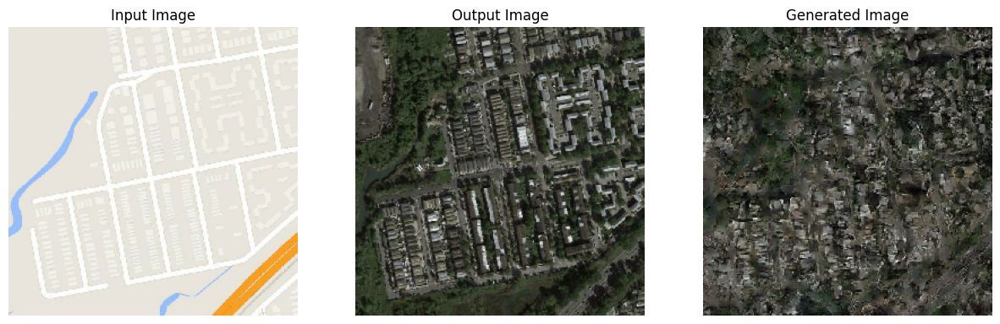

Epoch 200/200 :             temps écoulé : 394.47 min             (moy: 0.11s/img)


ValueError: Invalid filepath extension for saving. Please add either a `.keras` extension for the native Keras format (recommended) or a `.h5` extension. Use `model.export(filepath)` if you want to export a SavedModel for use with TFLite/TFServing/etc. Received: filepath=/kaggle/working/pix2pix_model.

In [49]:
EPOCHS=200
train(train_dataset, EPOCHS)

In [52]:
checkpoint.restore(tf.train.latest_checkpoint("/kaggle/working/ckpt-20"))
generator.save('/kaggle/working/map2sat_final.h5', save_format='h5')

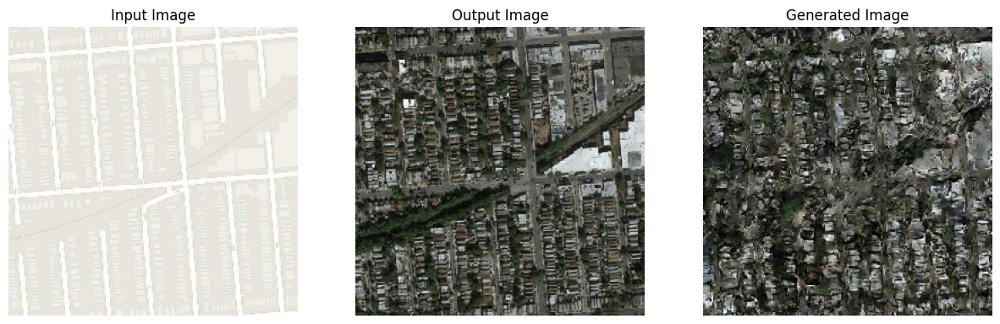

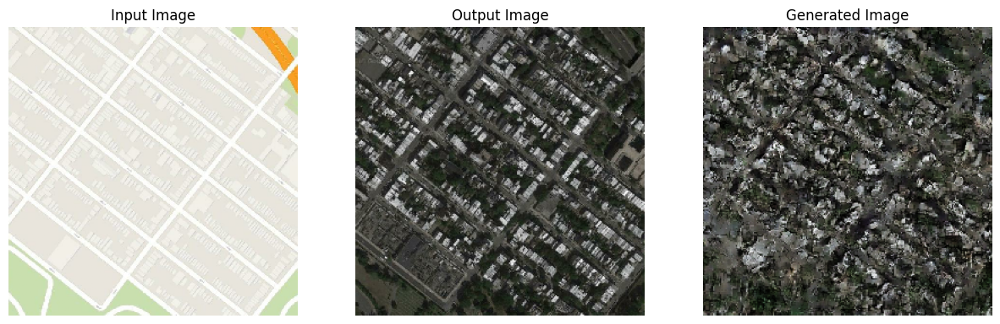

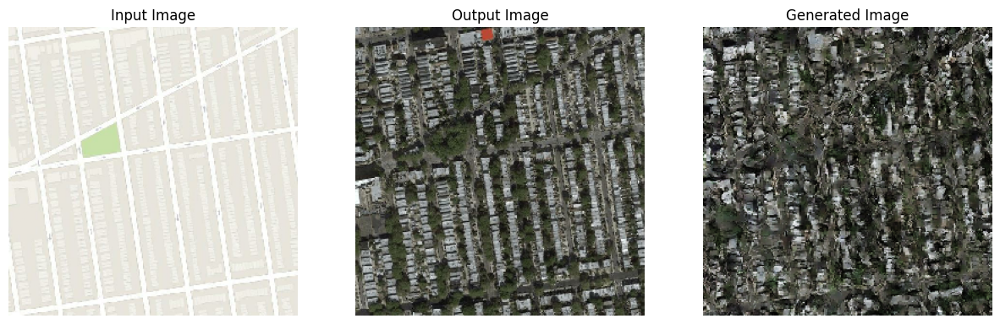

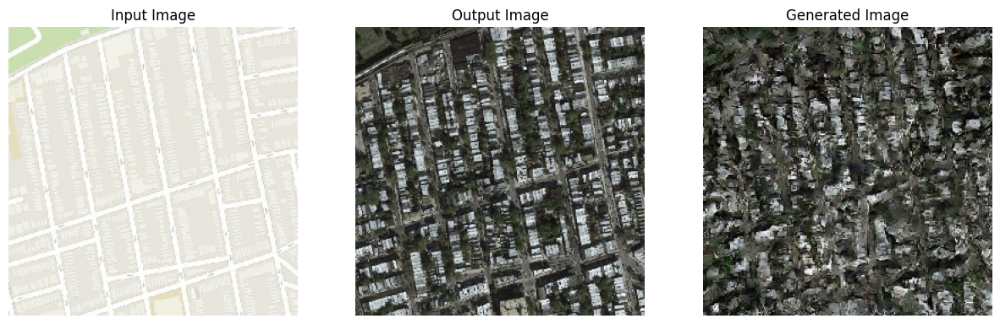

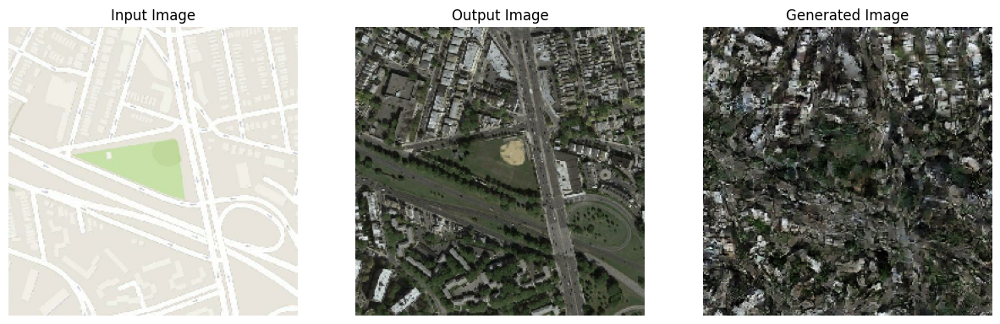

...

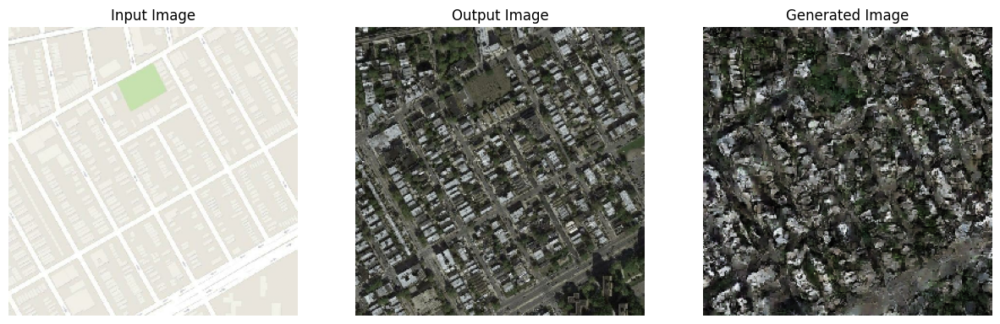

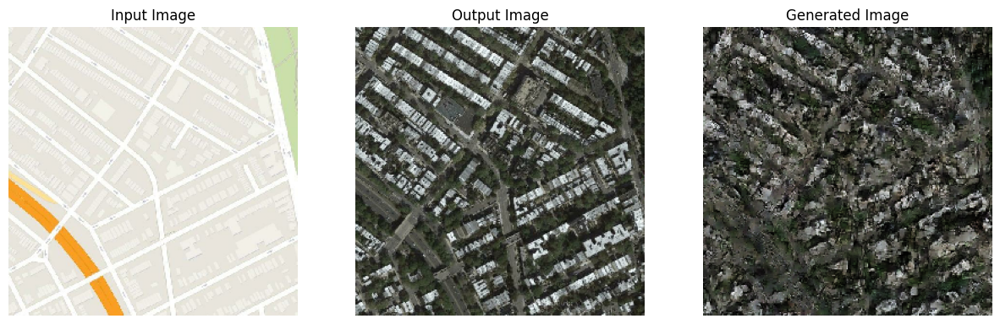

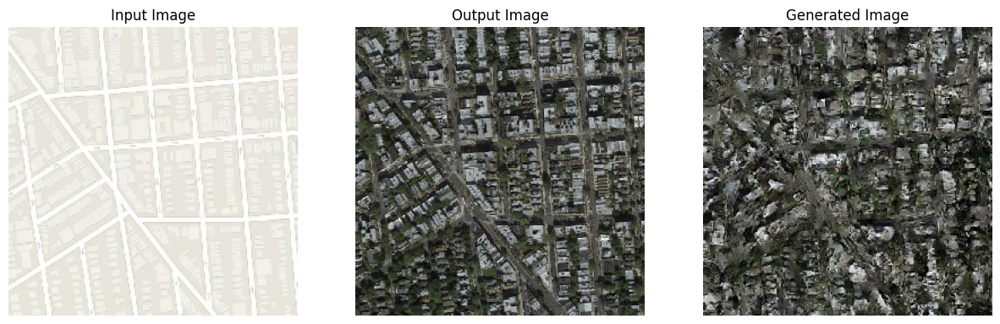

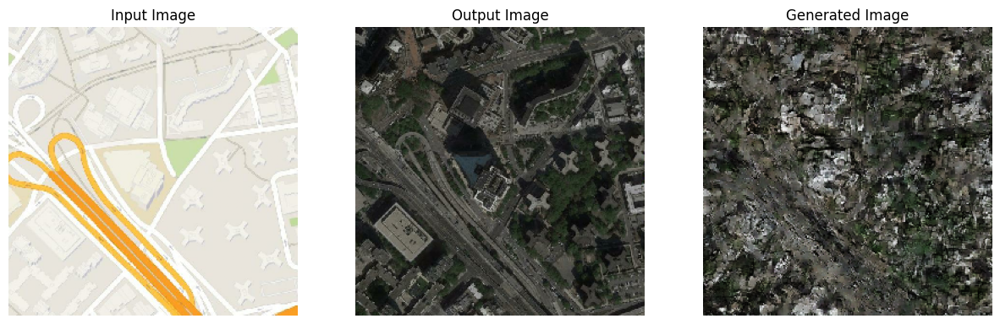

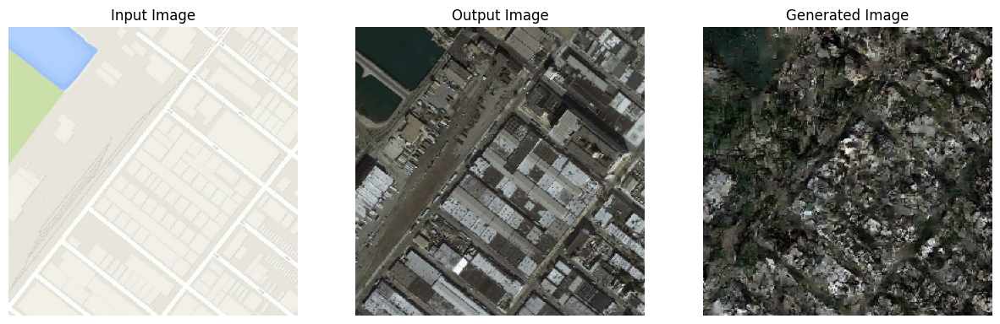

In [59]:
map2sat_final = tf.keras.models.load_model("/kaggle/working/map2sat_final.h5")
for example_input, example_target in test_dataset.take(20):
    generate_images(map2sat_final, example_input, example_target)

In the *Pix2Pix* paper, the dataset should be run for 200 epochs. Here are the results obtained from the first 60 epochs:  
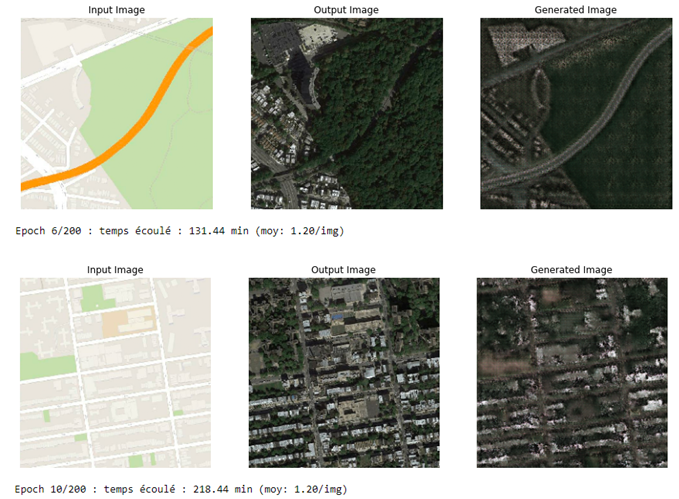

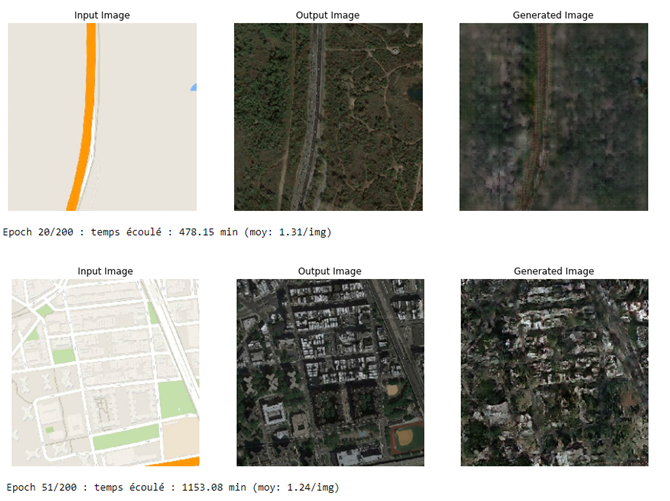

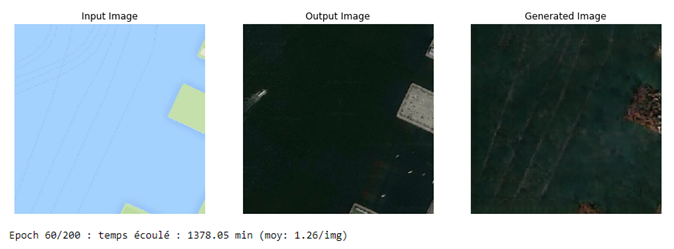